In [18]:
import pandas as pd
from itertools import product
import matplotlib.pyplot as plt
import numpy as np
from utils.create_stimuli import *
from utils.qlearningAgent import QlearningAgent
from utils.gaussian_smoothed_performance import *
from sklearn.cluster import KMeans
from utils.column_game import ColumnGame
from hyperopt import fmin, tpe, hp, Trials, STATUS_OK
from collections import Counter



In [19]:
# Load data
df = pd.read_csv("data/data_cleared_barcelona2.csv")
df[(df["horizon"] == 2)]

,Unnamed: 0,subject,horizon,nte,trial,order,big,right,first,performance,stimuli,presented_stimuli
300,300,1.0,2.0,1.0,1,4,True,False,True,NaN,0.605,"[0.605, 0.455]"
301,301,1.0,2.0,2.0,2,4,True,True,True,NaN,0.415,"[0.265, 0.415]"
302,302,1.0,2.0,3.0,3,4,True,True,False,0.151515,0.225,"[0.075, 0.225]"
303,303,1.0,2.0,1.0,4,4,False,False,False,NaN,0.395,"[0.395, 0.545]"
304,304,1.0,2.0,2.0,5,4,True,False,False,NaN,0.355,"[0.355, 0.205]"
...,...,...,...,...,...,...,...,...,...,...,...,...
10795,10795,18.0,2.0,2.0,86,3,False,True,False,NaN,0.590,"[0.79, 0.59]"
10796,10796,18.0,2.0,3.0,87,3,True,True,False,1.000000,0.980,"[0.78, 0.98]"
10797,10797,18.0,2.0,1.0,88,3,False,True,True,NaN,0.525,"[0.535, 0.525]"
10798,10798,18.0,2.0,2.0,89,3,False,False,True,NaN,0.715,"[0.715, 0.725]"


## Agrupament de subjectes basant-se en la performance

/home/mpirla/Documentos/Uni/TFG/Entrega/utils/gaussian_smoothed_performance.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[data.isna()] = 0


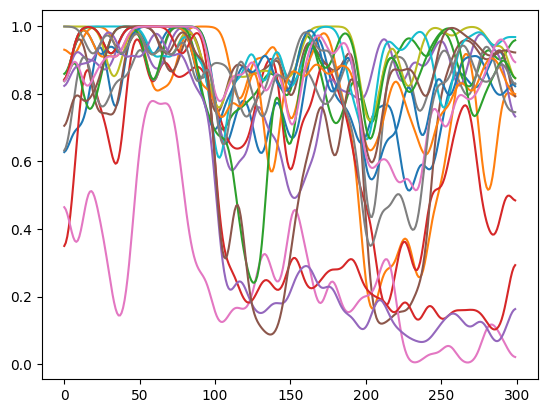

In [26]:
subjects_performance = []
for subject in range(1, 19):
    subjects_performance.append(make_performance_data(df, subject))
    plt.plot(subjects_performance[-1])



## Subject clustering based in their performance
Since now i have a simple feature descriptor of the strategy of the subjects, i think it would be interesting to find clusters of similar strategies in the data.
For this study i will use Kmeans.

In [27]:

perf_data = pd.DataFrame(subjects_performance)

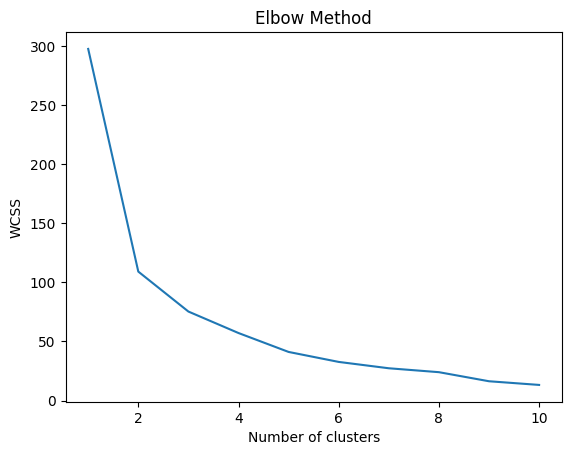

In [28]:


wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(perf_data)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()


With the elbow method we can see that the best number of clusters is between 2 and 3, i will use three since 2 are to little groups.
Amb el mètode del colze podem veure que el millor número de grups és entre 2 i 3, faré servir 3 per aquest estudi

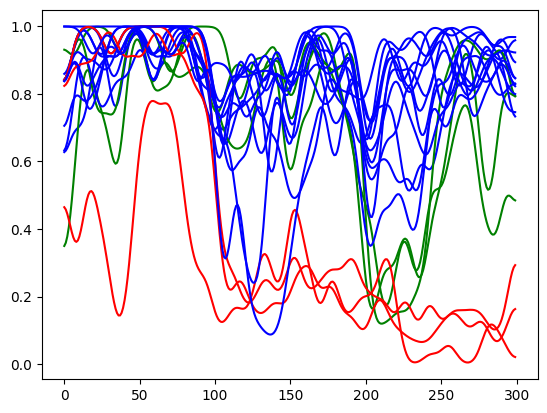

In [34]:
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(perf_data)
groups = kmeans.labels_


for subject in range(1, 19):
    group = groups[subject-1]
    match group:
        case 0:
            plt.plot(subjects_performance[subject-1], color="red")
        case 1:
            plt.plot(subjects_performance[subject-1], color="blue")
        case 2:
            plt.plot(subjects_performance[subject-1], color="green")
        case 3:
            plt.plot(subjects_performance[subject-1], color="yellow")

En aquest gràfic podem veure els tres grups que el Kmeans ha determinat:
- **Grup 0**(verd): Aquest grup sembla que aconsegueix una més o menys bona recompensa en les primeres dues fases de l'experiment, però en la última, amb horitzó igual a 2, sembla que l'hi costa si és que arriba a trobar l'estratègia òptima.
- **Grup 1**(blau): Aquest grup és el més gran. Hi ha diferències entre subjectes del grup, però sembla que tots aconsegueixen trobar sense masses problemes les estratègies òptimes en les tres fases.
- **Grup 2**(vermell): Aquest grup és el més peculiar, sembla que només han trobat l'estratègia òptima en la primera fase. Sospito que és perquè aquests subjectes son els que han escollit la majoria de les vegades l'estímul més gran.

With this caracteritzation, we can try to create an agent that replicates each of this groups.
The exercise is composed of:
- 100 horizon 0 episodes.
- 100 horizon 1 episodes.
- 100 horizon 2 episodes.

In [24]:
groupdata = [[], [], []]
for s in range(len(groups)):
    groupdata[groups[s]].append(subjects_performance[s])

In [25]:
groups

array([1, 2, 1, 2, 1, 2, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], dtype=int32)

First, I will make an agent learn for this process and then try to calculate it's general performance.

### First try model free agent
In this first case, the agent will not use the information from the previous phase, making it start over in each change of horizon.

In [10]:
def run_episode(agent, clear_table = False, full_adaptation = False, full_data=False):

    tries = []

    # 100 episodes of horizon 0
    g = ColumnGame(agent, 0, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    if clear_table:
        agent.clear_table()
    elif full_adaptation:
        adapt_q_table(agent, 1)

    # 100 episodes of horizon 1
    g = ColumnGame(agent, 1, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    if clear_table:
        agent.clear_table()
    elif full_adaptation:
        adapt_q_table(agent, 2)

    # 100 episodes of horizon 2
    g = ColumnGame(agent, 2, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    df = pd.concat(tries, ignore_index=True)
    l_perf = make_performance_data_agent(df)
    if full_data:
        return df
    return l_perf

def adapt_q_table(agent, next_horizon):
    state_symetry = 2**(next_horizon+1)
    last_qtable = agent.q_table.copy()
    for key, value in last_qtable.items():
        agent.q_table[(key[0]+state_symetry, key[1])] = value    

(0.0, 1.0)

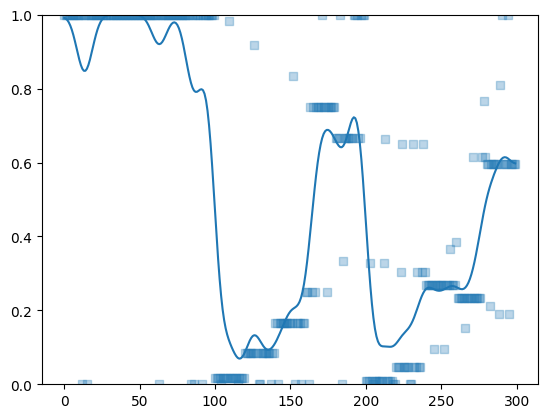

In [9]:
agent = QlearningAgent(exploration_factor=0.2)

df = run_episode(agent, clear_table=True, full_data=True)
l_perf = make_performance_data_agent(df)
plt.plot(l_perf)
performances = df[df["nte"]-1 == df["horizon"]]["performance"]
plt.scatter(list(range(len(performances))), performances, marker=',', alpha=0.3)
plt.ylim(0, 1)


We can see at the 100 and 200 mark a dip in the general_performance, since the optimal performance changes an the q-table is cleared.

### Model based Q-learning agent
Now that we've seen how the agent does when it does not use previous information for the current phase. Now I will make the agent try to use data calculated in previous phases in order to make it learn faster.

By the way the states are defined, the data from a previous phase is compatible.

Per horizon = 0, els estats son:
            
            2
          /   \
         1     3

I per horizon = 1, els estats son:

            4
          /   \
        2       6
      /   \   /   \
     1     3 5     7

De manera que la part de abaix a la esquerra (els estats 1, 2 i 3) es pot fer servir de la anterior fase i a sobre aquella part ja esta entrenada de la manera optima.

(0.0, 1.0)

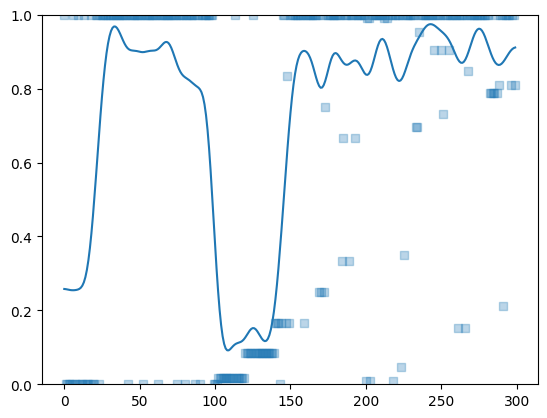

In [10]:
agent = QlearningAgent(exploration_factor=0.2)

df = run_episode(agent, full_data=True)
l_perf = make_performance_data_agent(df)
plt.plot(l_perf)
performances = df[df["nte"]-1 == df["horizon"]]["performance"]
plt.scatter(list(range(len(performances))), performances, marker=',', alpha=0.3)
plt.ylim(0, 1)

(0.0, 1.0)

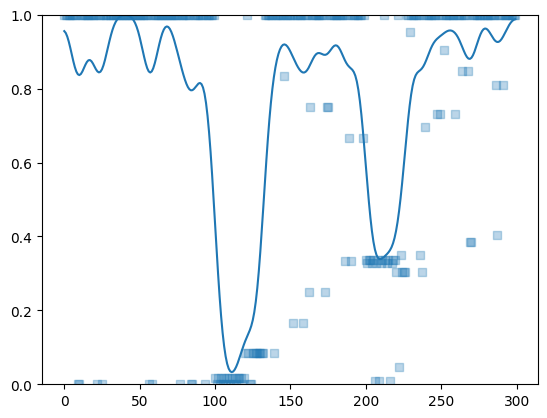

In [11]:
agent = QlearningAgent(exploration_factor=0.2)

df = run_episode(agent, full_adaptation=True, full_data=True)
l_perf = make_performance_data_agent(df)
plt.plot(l_perf)
performances = df[df["nte"]-1 == df["horizon"]]["performance"]
plt.scatter(list(range(len(performances))), performances, marker=',', alpha=0.3)
plt.ylim(0, 1)

Podem veure com encara hi ha les baixades en el rendiment general (general performance), encara que son molt més baixos si no imperceptibles.

### Primera prova de similaritud de rendiment general
En aquesta primera prova, buscare en quins dels grups pertany cada agent basant-se en el seu rendiment.

In [15]:
from collections import Counter

performances = []

for i in range(100):
    agent = QlearningAgent(exploration_factor=0.2)

    tries = []

    # 100 episodes of horizon 0
    g = ColumnGame(agent, 0, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)
    agent.clear_table()

    # 100 episodes of horizon 1
    g = ColumnGame(agent, 1, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)
    agent.clear_table()

    # 100 episodes of horizon 2
    g = ColumnGame(agent, 2, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    df = pd.concat(tries, ignore_index=True)
    l_perf = make_performance_data_agent(df)
    performances.append(l_perf)



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.722 0.732]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.722 0.732]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.722 0.732]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.722 0.732]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best rew 0.732
worst rew 0.722
states [[0.732 0.722]]



ep rew 0.732
best re

In [16]:
group_list = kmeans.predict(performances)
ct = Counter(group_list)
ct

Counter({2: 67, 1: 22, 0: 11})

En el model free, es pot veure que queda entre el grup 2 i el 1, de manera que a vegades l'agent consegueix trobar les estratègies òptimes, quedant en el grup 1, encara que a vegades no aconsegueix modelar la estratègia òptima, quedant en el grup 2.

In [17]:
from collections import Counter

performances = []

for i in range(100):
    agent = QlearningAgent(exploration_factor=0.2)

    tries = []

    # 100 episodes of horizon 0
    g = ColumnGame(agent, 0, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    # 100 episodes of horizon 1
    g = ColumnGame(agent, 1, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    # 100 episodes of horizon 2
    g = ColumnGame(agent, 2, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    df = pd.concat(tries, ignore_index=True)
    l_perf = make_performance_data_agent(df)
    performances.append(l_perf)



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.301 0.291]]



ep rew 0.301
best rew 0.301
worst rew 0.291
states [[0.301 0.291]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.301 0.291]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.301 0.291]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.301
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.301 0.291]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.301 0.291]]



ep rew 0.291
best rew 0.301
worst rew 0.291
states [[0.291 0.301]]



ep rew 0.291
best re

In [18]:
group_list = kmeans.predict(performances)

ct = Counter(group_list)
ct

Counter({1: 78, 2: 22})

In [14]:
performances = []

for _ in range(100):
    agent = QlearningAgent(exploration_factor=0.2)
    p = run_episode(agent, full_adaptation=True)
    performances.append(p)

group_list = kmeans.predict(performances)

ct = Counter(group_list)
ct



Counter({1: 75, 2: 23, 0: 2})

Amb la modificació, podem veure que la majoria de les vegades, el agent s'assembla a el comportament del grup 1. Ara es pot buscar els millors paràmetres de l'agent Q-learning per assimilar-se als subjectes del grup 1.

Per evitar elements aleatòris, farem el hyperparameter fitting corrent l'escenari vàries vegades amb els mateixos paràmetres i determinarem la similitud com la mitjana de les similituds.
també tindrem varies mesures objectiu, una de cada subjecte, de manera que buscarem la minimització de la mitjana de les distàncies.

In [12]:
def run_episode(agent, clear_table = False, full_adaptation = False):

    tries = []

    # 100 episodes of horizon 0
    g = ColumnGame(agent, 0, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    if clear_table:
        agent.clear_table()
    elif full_adaptation:
        adapt_q_table(agent, 1)

    # 100 episodes of horizon 1
    g = ColumnGame(agent, 1, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    if clear_table:
        agent.clear_table()
    elif full_adaptation:
        adapt_q_table(agent, 2)

    # 100 episodes of horizon 2
    g = ColumnGame(agent, 2, 100)
    for i in range(100):
        df_game = g.start_game()
        tries.append(df_game)

    df = pd.concat(tries, ignore_index=True)
    l_perf = make_performance_data_agent(df)
    return l_perf

def adapt_q_table(agent, next_horizon):
    state_symetry = 2**(next_horizon+1)
    last_qtable = agent.q_table.copy()
    for key, value in last_qtable.items():
        agent.q_table[(key[0]+state_symetry, key[1])] = value    

In [10]:
def hyperparameter(obj):
    
    space = {
        'learning_rate': hp.loguniform('learning_rate', np.log(0.001), np.log(1)),
        'discount_factor': hp.uniform('discount_factor', 0.1, 1),
        'epsilon': hp.loguniform('epsilon', np.log(0.0001), np.log(1)),
        'eps_prog': hp.choice('eps_prog', [0.99, 0.995, 0.999, 1]),
        'big_bias': hp.choice('big_bias', [0, 2, 5]),
        'full_adaptation': hp.choice('full_adaptation', [True, False]),
        'clear_table': hp.choice('clear_table', [True, False]),
        'objective_subjects': obj
    }
    def objective(params):
        learning_rate = params['learning_rate']
        discount_factor = params['discount_factor']
        epsilon = params['epsilon']
        eps_prog = params['eps_prog']
        big_bias = params['big_bias']
        objective_subjects = params['objective_subjects']
        
        diffs = []
        for _ in range(4):  # Adjust if you want to run more iterations
            agent = QlearningAgent(
                learning_rate=learning_rate, 
                discount_rate=discount_factor, 
                exploration_factor=epsilon, 
                exploration_factor_progression=eps_prog, 
                biases={'B': big_bias}
            )
            performance = run_episode(agent, full_adaptation=params['full_adaptation'], clear_table=params['clear_table'])
            r_dif = []
            for s in objective_subjects:
                r_dif.append(calculate_euclidean_difference(s, performance))
            diffs.append(np.mean(r_dif))
        
        difference = np.mean(diffs)
        return {'loss': difference, 'status': STATUS_OK}

    # Run hyperparameter optimization
    trials = Trials()
    best = fmin(fn=objective,
                space=space,
                algo=tpe.suggest,
                max_evals=100,  # Adjust based on your computational resources
                trials=trials)

    # Translate best params from indices to actual values
    best['eps_prog'] = [0.99, 0.995, 0.999, 1][best['eps_prog']]
    best['big_bias'] = [0, 2, 5][best['big_bias']]
    print("Best Parameters:", best)
    return best


In [ ]:
best = hyperparameter(groupdata[1])
best

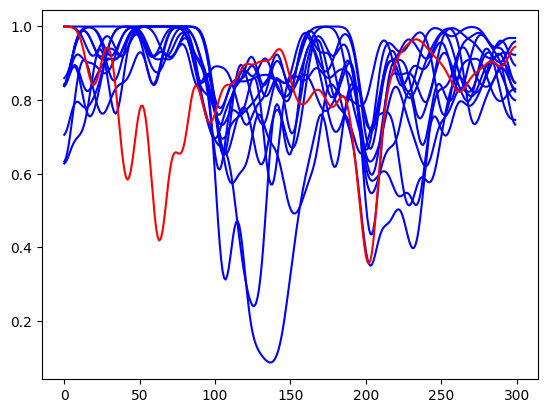

In [12]:
agent = QlearningAgent(learning_rate = best['learning_rate'], discount_rate=best['discount_factor'], exploration_factor=best['epsilon'], exploration_factor_progression=best['eps_prog'], biases={'B': best['big_bias']})
per = run_episode(agent)

for p in groupdata[1]:
    plt.plot(p, color = "blue")
plt.plot(per, color = "red")



Es pot veure que al final la performance en aquest grup hi ha molta variavilitat, de manera que cada fitting dona un set de parametres diferents, de manera que potser el fiting serà millor fer-ho per cada subjecte i veure quines diferencies.

100%|██████████| 100/100 [07:02<00:00,  4.22s/trial, best loss: 2.664085363765367]
Best Parameters: {'big_bias': 1, 'clear_table': 1, 'discount_factor': 0.6473515046782836, 'eps_prog': 1, 'epsilon': 0.42806121146957865, 'full_adaptation': 0, 'learning_rate': 0.8282195187874842}
best params: {'big_bias': 1, 'clear_table': 1, 'discount_factor': 0.6473515046782836, 'eps_prog': 1, 'epsilon': 0.42806121146957865, 'full_adaptation': 0, 'learning_rate': 0.8282195187874842}
100%|██████████| 100/100 [07:02<00:00,  4.22s/trial, best loss: 3.8011166988776215]
Best Parameters: {'big_bias': -1, 'clear_table': 0, 'discount_factor': 0.7091478177166978, 'eps_prog': 0.995, 'epsilon': 0.6919221307541582, 'full_adaptation': 0, 'learning_rate': 0.5191241492315208}
best params: {'big_bias': -1, 'clear_table': 0, 'discount_factor': 0.7091478177166978, 'eps_prog': 0.995, 'epsilon': 0.6919221307541582, 'full_adaptation': 0, 'learning_rate': 0.5191241492315208}
100%|██████████| 100/100 [05:47<00:00,  3.47s/tri

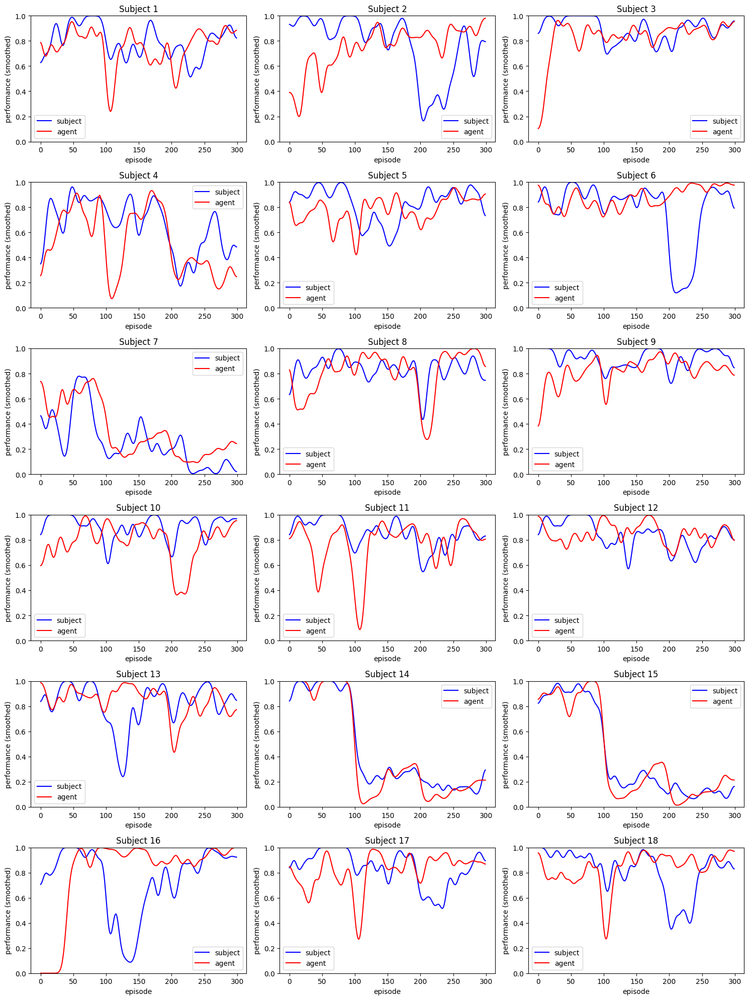

In [65]:
fig, axes = plt.subplots(6, 3, figsize=(15, 20))  # 6 rows and 3 columns

# Flatten the axes array for easy iteration
axes = axes.flatten()
best = []
# Plot the histograms
for i in range(len(subjects_performance)):
    s_data = subjects_performance[i]
    params= hyperparameter([s_data])
    print("best params:", params)
    agent = QlearningAgent(learning_rate = params['learning_rate'], discount_rate=params['discount_factor'], exploration_factor=params['epsilon'], exploration_factor_progression=params['eps_prog'], biases={'B': params['big_bias']})
    per = run_episode(agent, clear_table=params['clear_table'], full_adaptation=params["full_adaptation"])
    best.append(params)
    axes[i].plot(s_data, color = "blue", label="subject")
    axes[i].plot(per, color = "red", label="agent")

    axes[i].set_title("Subject " + str(i+1))
    axes[i].set_ylabel("performance (smoothed)")
    axes[i].set_xlabel("episode")
    axes[i].set_ylim(0, 1)
    axes[i].legend()

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

parameters_dataframe = pd.DataFrame(best)

In [91]:
params = pd.DataFrame(best)
params["group"] = groups
params.loc[params["clear_table"] == 1, "full_adaptation"] = 0

params.loc[params["big_bias"] == 0, "big_bias"] = 2
params.loc[params["big_bias"] == 1, "big_bias"] = 5
params.loc[params["big_bias"] == -1, "big_bias"] = 0
params

,big_bias,clear_table,discount_factor,eps_prog,epsilon,full_adaptation,learning_rate,group
0,5,1,0.647352,1.000,0.428061,0,0.828220,1
1,0,0,0.709148,0.995,0.691922,0,0.519124,2
2,0,1,0.497646,1.000,0.315385,0,0.940391,1
3,2,0,0.294252,0.995,0.605855,1,0.330471,2
4,2,0,0.587212,0.999,0.453248,1,0.924388,1
5,5,0,0.735615,0.995,0.429183,0,0.847993,2
6,2,1,0.406859,0.990,0.958367,0,0.095015,0
7,5,0,0.414832,0.995,0.478087,1,0.821866,1
8,0,1,0.657900,0.999,0.306111,0,0.964880,1
9,0,1,0.539382,1.000,0.255358,0,0.997352,1


In [81]:
params[["learning_rate", "discount_factor", "epsilon", "big_bias", "group"]].groupby("group").mean()

,learning_rate,discount_factor,epsilon,big_bias
group,,,,
0,0.085487,0.502698,0.406183,4.00
1,0.862243,0.587085,0.333223,3.25
2,0.565863,0.579672,0.575653,3.00


In [82]:
params[["learning_rate", "discount_factor", "epsilon", "big_bias", "group"]].mean()

learning_rate      0.683387
discount_factor    0.571785
epsilon            0.385788
big_bias           3.333333
group              1.000000
dtype: float64

In [83]:
params[["learning_rate", "discount_factor", "epsilon", "big_bias", "group"]].groupby("group").median()

,learning_rate,discount_factor,epsilon,big_bias
group,,,,
0,0.083992,0.406859,0.193759,5.0
1,0.891760,0.537016,0.310748,2.0
2,0.519124,0.709148,0.605855,2.0


In [84]:
params[["learning_rate", "discount_factor", "epsilon", "big_bias", "group"]].median()

learning_rate      0.825043
discount_factor    0.537016
epsilon            0.323580
big_bias           2.000000
group              1.000000
dtype: float64

In [85]:
params[["learning_rate", "discount_factor", "epsilon", "big_bias", "group"]].groupby("group").var()

,learning_rate,discount_factor,epsilon,big_bias
group,,,,
0,0.000079,0.206872,0.232735,3.000000
1,0.011945,0.016329,0.014716,2.386364
2,0.068595,0.061273,0.017942,3.000000


In [86]:
params[["learning_rate", "discount_factor", "epsilon", "big_bias"]].var()

learning_rate      0.103912
discount_factor    0.043131
epsilon            0.047399
big_bias           2.352941
dtype: float64

[1, 2, 0]


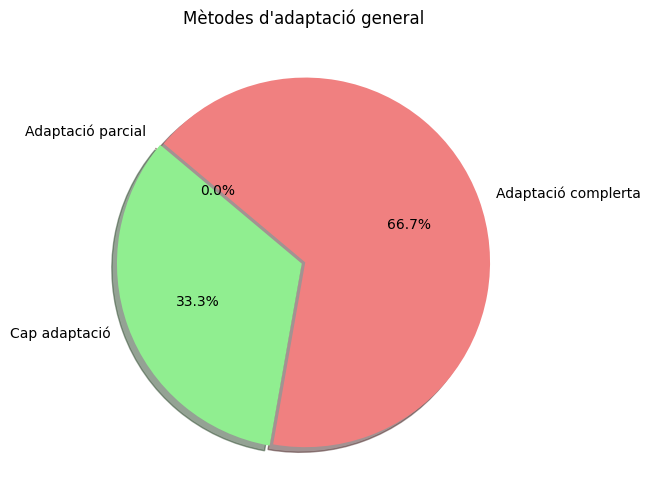

In [87]:
# Data for the pie chart
labels = ['Cap adaptació', 'Adaptació complerta', "Adaptació parcial"]
params1 = params[params["group"] == 0]
sizes = [
    len(params1[params1["clear_table"] == 1]), 
    len(params1[params1["full_adaptation"] == 1]),
    len(params1[(params1["full_adaptation"] == 0) & (params1["clear_table"] == 0)]),
    ]
colors = ['lightgreen', 'lightcoral', 'red']
explode = (0.01, .01, .01)  # explode the first slice (True)
print(sizes)
# Plotting the pie chart
plt.figure(figsize=(6, 6))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',
        shadow=True, startangle=140)
plt.title("Mètodes d'adaptació general")
plt.show()

[7, 3, 2]


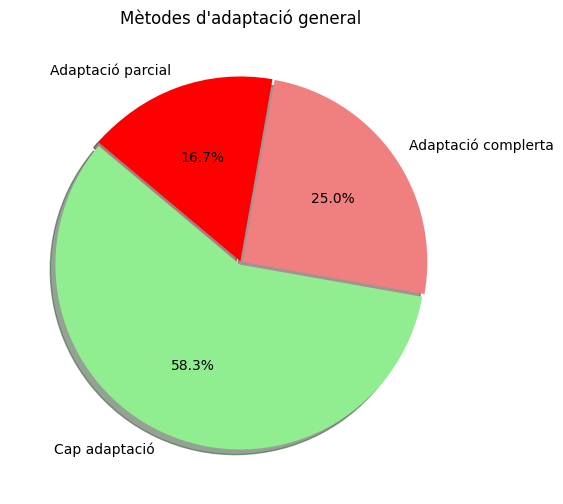

In [88]:


# Data for the pie chart
labels = ['Cap adaptació', 'Adaptació complerta', "Adaptació parcial"]
params1 = params[params["group"] == 1]
sizes = [
    len(params1[params1["clear_table"] == 1]), 
    len(params1[params1["full_adaptation"] == 1]),
    len(params1[(params1["full_adaptation"] == 0) & (params1["clear_table"] == 0)]),
    ]
colors = ['lightgreen', 'lightcoral', 'red']
explode = (0.01, .01, .01)  # explode the first slice (True)
print(sizes)
# Plotting the pie chart
plt.figure(figsize=(6, 6))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',
        shadow=True, startangle=140)
plt.title("Mètodes d'adaptació general")
plt.show()

[0, 1, 2]


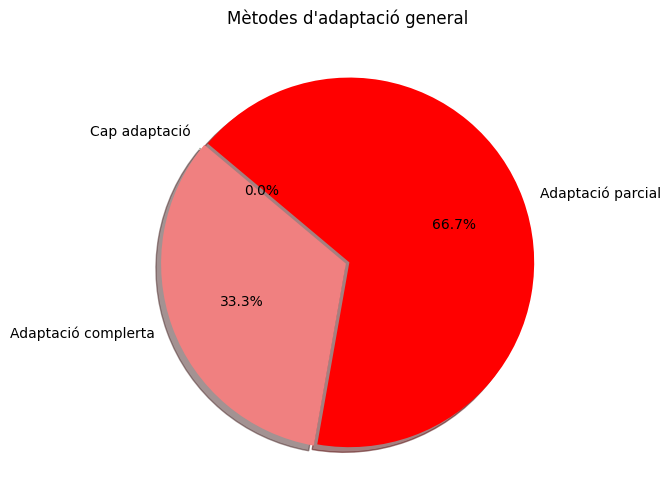

In [89]:
# Data for the pie chart
labels = ['Cap adaptació', 'Adaptació complerta', "Adaptació parcial"]
params1 = params[params["group"] == 2]
sizes = [
    len(params1[params1["clear_table"] == 1]), 
    len(params1[params1["full_adaptation"] == 1]),
    len(params1[(params1["full_adaptation"] == 0) & (params1["clear_table"] == 0)]),
    ]
colors = ['lightgreen', 'lightcoral', 'red']
explode = (0.01, .01, .01)  # explode the first slice (True)
print(sizes)
# Plotting the pie chart
plt.figure(figsize=(6, 6))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',
        shadow=True, startangle=140)
plt.title("Mètodes d'adaptació general")
plt.show()

In [92]:
params.to_csv("parameters_fitting.csv")